<a href="https://colab.research.google.com/github/D3TaLES/In-The-Mix/blob/main/computation/InTheMix2_ComputationDay1_MASTER.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Welcome to In the Mix: Computation Day 1! 

In [ ]:
%%capture
#@title Install needed packages and import needed modules 
#@markdown This may take a minute or two to run...
! pip install pyscf
! pip install rdkit
! pip install geometric
! pip install py3Dmol

import os
import sys
import pyscf
import py3Dmol
import matplotlib.pyplot as plt

from pyscf.hessian import thermo
from pyscf import gto, scf, dft, tools, lo
from pyscf.geomopt.geometric_solver import optimize

from rdkit import Chem
from rdkit.Chem import Draw
from rdkit.Chem import AllChem
from rdkit.Chem.Draw import IPythonConsole

# Introduction to Computational Chemistry

##What is Computational Chemistry?

Computational chemists use chemistry, physics, and math to model how particles interact. These models can be used to validate experimental data, gain insights that experiments cannot, and study molecules that have not yet been synthesized. A major advantage of DFT is its ability to efficiently screen a vast chemical space. In D3TaLES we use DFT to narrow down the pool of electrolyte molecules to a small set that can be tested experimentally. DFT can quickly and inexpensively calculate properties such as redox potential that are used to evaluate the suitability of a molecule for use in a redox flow battery.

![](https://drive.google.com/uc?export=view&id=1eB63xYXf4ZjGOYYUeTXc9WkYiQpvxed9)


### Density Functional Theory (DFT)

Material properties are determined by the interactions of electrons and nuclei. These interactions can be described using the **Schrodinger equation**. 

\begin{equation}
\hat{H}Ψ(r,R)=E(r,R)Ψ(r,R)
\end{equation}

where Ψ(r,R) is the wavefunction, E(r,R) is the energy (this is what we want), r and R are electronic and nuclear coordinates.

The Hamiltonian operator $\hat{H}$ consists of both nuclei and electrons, making it too complicated to solve. To simplify things, we make two approximations. The first is to assume that the nuclei are stationary, which is valid because they are significantly more massive than electrons. The second is to replace the electrons with **electron densit**y ρ(x,y,z). This replaces an equation of 3n dimensions (where n is the number of electrons) with a much simpler three dimensional equation. 

![](https://drive.google.com/uc?export=view&id=1Ex0I4KyI7hY8R2wXD6QgswZ7aQMWryLE)

To sum up DFT simply:
* The Schrodinger equation of the real wavefunction is too complicated to solve.
* To simplify the equation, we "glue" the nuclei in place and replace the electrons with electron density.
* We now need to find a wavefunction to describe the electron density.

**How do we find this fictitious wavefunction???**

The model wavefunction is constructed from a linear combination of simple functions called **basis functions**. Gaussian functions, plane waves, and slater-type orbitals are among the types of functions that can be used as basis functions. The set of these basis functions is called the **basis set**. Much like legos, the larger the basis set is, the more accurately the wavefunction can be modeled.

![](https://drive.google.com/uc?export=view&id=1BbE0MRNTV3SLeJUICvPnlehHHVDbLLpA) 

Circling back to the Schrodinger equation, the Hamiltonian of this simplified system has several parts.


<div align="center">$\hat{H}=\hat{T}+{V}_{Ne}+{V}_{ee}$
<div align="left">

*   $\hat{T}$: Kinetic energy.
*   ${V}_{Ne}$: Nuclear-electron attraction
*   ${V}_{ee}$: Electron-electron repulsion
*   $\hat{H}$: Hamiltonian operator

${V}_{ee}$ is the tricky term. It has two parts: the coulomb interaction and the exchange-correlation term.

\begin{equation}
V_{ee}=V_{H}+V_{x}
\end{equation}

The coulomb interaction can be solved for, but the exchange interaction cannot. We approximate the energy stemming from the exchange-correlation term using an approximation called an **exchange-correlation functional**, hereafter referred to as a functional. The exact form of this functional is not known, so many guesses exist to approximate this term.

We're going to run several types of calculations, each with its own unique inputs and outputs. 

![](https://drive.google.com/uc?export=view&id=18Vsu9KyOqZMEfEKfm3jDkXQXf7MEK6sG) 

### Types of Calculations
Today, we will discuss three types of calculations: 

![](https://drive.google.com/uc?id=1p_GcfJeN8dUkMQHef1Yb9QWPKchpnFTa)

# Running Calculations
There are several different types of sofwares for running quantum chemical computations. Some are free and open-source; some are not. For today, exercises, we will be usin [PySCF](https://pyscf.org/), a free open-source software for computational chemistry. 

## Prep Calculations

### Making Molecules
To build your molecule, our will first need to draw your molecule on [this website](http://www.cheminfo.org/flavor/malaria/Utilities/SMILES_generator___checker/index.html). The website will convert your drawing into a string of characters. This string moleuclar representation is called a `smiles` string. You will then copy the smiles string into the cell below. Then, the code in the cell will use a software called `rdkit` to convert the smiles into an object readible by the Psi4 software: `smiles` &rarr; `rdkit` &rarr; `psi4` 

To Summarize,  
1. Go to [this website](http://www.cheminfo.org/flavor/malaria/Utilities/SMILES_generator___checker/index.html) where you can draw the moleucle structure. 
2. Copy the text string from the `SMILES code` box. 
3. Paste the copied text into the cell below. 

Your smiles:  O=c1ccc(=O)cc1


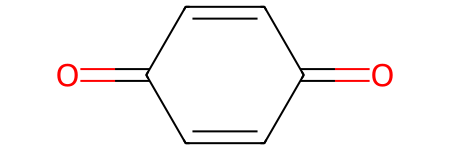

In [ ]:
#@title Build your molecule
#@markdown Copy the smiles text into this cell. 

smiles = "O=c1ccc(=O)cc1" #@param {type:"string"}
molecule_name = 'quinone' #@param {type:"string"}
# drawing_style = "stick" #@param ['stick', 'sphere', 'line','carton'] 
print("Your smiles: ", smiles)

# Establish RDKit mol object
rd_mol = Chem.MolFromSmiles(smiles)
rdmol_hs = Chem.rdmolops.AddHs(rd_mol)
AllChem.EmbedMolecule(rdmol_hs)
Chem.MolToXYZFile(rdmol_hs, "{}.xyz".format(molecule_name))

rd_mol

In [ ]:
#@markdown View moleucle in 3D
v = py3Dmol.view()
v.addModel(Chem.MolToMolBlock(rd_mol), 'mol')
v.setStyle({'stick':{}})
v.show()

You appear to be running in JupyterLab (or JavaScript failed to load for some other reason). You need to install the 3dmol extension: 
 jupyter labextension install jupyterlab_3dmol

#### Charge and Spin
**Charge**: Molecules are made of atoms which are made of positively charged protons and negatively charged electrons. In most molecules, there are an equal number of protons and electrons, so the total charge is 0. However, when an electron is added or taken away from the molecule, the molecule will have a negative or positive charge, respectively. 

**Spin Multiplicity**: Electrons are generally grouped into pairs of two. However, if there is an odd number of electrons, there will be an electron left over. This is an unpaired electron. Spin multiplicity is related to the number of unpaired electrons: it is `2s` where `s` is the amount of unpaired spin. Each electron has a spin of `1/2`. A normal uncharged molecule has no unpaired electrons, so its spin multiplicity is 0. If an electron is added to this molecule, it will now have a charge of -1 and a spin multiplicity of `2*(1/2)`, which is 1. 

In [ ]:
#@title Select Charge and Spin
#@markdown Before begining calculations, you must select the charge and spin of your molecule. 
charge = 0 #@param {type:"number"}
spin  = 0 #@param {type:"number"}

In [ ]:
#@title Select Level of  Theory 
#@markdown Before begining calculations, you must select the functional and basis set you will use during the calculations 

#@markdown (For more on what a functional and basis set are, check out the theory section.). 

functional = "B3LYP" #@param ["","B3LYP", "wb97x"] 
basis_set = "6-31G" #@param ["","6-31G", "def2-SVP", "cc-pVDZ"] 

print("You have selectded the following level of theory: ")
print(functional, "/", basis_set)

You have selectded the following level of theory: 
B3LYP / 6-31G


## OPTIMIZATION

During a geometry optimization, the minimum energy configuration of the molecule is found. First, the wavefunction for the starting geometry is calculated. During each additional step, complex algorithms select a new geometry. Better geometries will have lower energy. This process is repeated until the forces on all the atoms become sufficiently low. The image below shows how the molecule's structure relates to its energy. There may be multiple minima, as is the case with A and C.

![](https://drive.google.com/uc?export=view&id=105KxAPMEH-ZRZDr9OEknMzpyVFVILVbt)

In [ ]:
# Set parameters
mol = gto.M(atom=F'{molecule_name}.xyz',  # Establish PySCF mol object
            charge = charge,
            spin = spin,
            basis = basis_set, 
            verbose=0
            )
mf = mol.KS()
mf.xc = functional  # Set functional

# Run Optimization 
mol_eq = optimize(mf)
# Save results to file
mol_eq.tofile(F'{molecule_name}_optimization.xyz')

geometric-optimize called with the following command line:
/usr/local/lib/python3.8/dist-packages/ipykernel_launcher.py -f /root/.local/share/jupyter/runtime/kernel-4920ab24-161e-4660-bea3-b7055fc8f1c6.json

                                        ())))))))))))))))/                     
                                    ())))))))))))))))))))))))),                
                                *)))))))))))))))))))))))))))))))))             
                        #,    ()))))))))/                .)))))))))),          
                      #%%%%,  ())))))                        .))))))))*        
                      *%%%%%%,  ))              ..              ,))))))).      
                        *%%%%%%,         ***************/.        .)))))))     
                #%%/      (%%%%%%,    /*********************.       )))))))    
              .%%%%%%#      *%%%%%%,  *******/,     **********,      .))))))   
                .%%%%%%/      *%%%%%%,  **              ********      .)

'12\nXYZ from PySCF\nO           2.69250       -0.04715        0.05207\nC           1.44080       -0.02526        0.02784\nC           0.69701        1.25356       -0.03178\nC          -0.65116        1.27716       -0.05775\nC          -1.44099        0.02526       -0.02777\nO          -2.69269        0.04721       -0.05200\nC          -0.69720       -1.25357        0.03184\nC           0.65096       -1.27717        0.05781\nH           1.29866        2.15619       -0.05287\nH          -1.21954        2.20031       -0.10136\nH          -1.29889       -2.15617        0.05292\nH           1.21937       -2.20030        0.10141'

In [ ]:
# View Optimization Process
mol_eq.__dict__

In [ ]:
#@markdown Generate HOMO/LUMO viewing data
mo_mf = dft.KS(mol_eq)
mo_mf.xc = functional
mo_mf.kernel();

n = mol_eq.tot_electrons()
print("Total number of electrons: ", n)
homo_idx = int(n/2) -1 
print("HOMO Index: ", homo_idx)
lumo_idx = int(n/2)
print("LUMO Index: ", lumo_idx)
_ = tools.cubegen.orbital(mol_eq, f'{molecule_name}_homo.cube', mo_mf.mo_coeff[:,homo_idx],  nx=60, ny=60, nz=60)
_ = tools.cubegen.orbital(mol_eq, f'{molecule_name}_lumo.cube', mo_mf.mo_coeff[:,lumo_idx],  nx=60, ny=60, nz=60)

Total number of electrons:  56
HOMO Index:  27
LUMO Index:  28


In [ ]:
#@title View Orbitals
#@markdown Select which molecular orbital to view


orbital = "homo" #@param ["homo", "lumo"] {type:"string"}


def draw_orbital(molecule_name, rd_mol, orb):
    view = py3Dmol.view(width=400,height=400)
    with open(f"./{molecule_name}_{orb}.cube") as f:
        cube_data = f.read()
    view.addVolumetricData(cube_data, "cube", {'isoval': -0.04, 'color': "red", 'opacity': 0.75})
    view.addVolumetricData(cube_data, "cube", {'isoval': 0.04, 'color': "blue", 'opacity': 0.75})
    view.addModel(Chem.MolToMolBlock(rd_mol), 'mol')
    view.setStyle({'stick':{}})
    view.zoomTo()
    view.update()
    view.clear()
    view.show()

draw_orbital(molecule_name, rd_mol, orbital)

You appear to be running in JupyterLab (or JavaScript failed to load for some other reason). You need to install the 3dmol extension: 
 jupyter labextension install jupyterlab_3dmol

You appear to be running in JupyterLab (or JavaScript failed to load for some other reason). You need to install the 3dmol extension: 
 jupyter labextension install jupyterlab_3dmol

## FREQUENCY ANALYSIS

In the geometry optimization step, we calculated the total electronic energy (E<sub>tot</sub>). However, this is not the true total energy of the system (E<sub>0</sub>)
To determine E<sub>0</sub>, we need to calculate the zero point vibrational energy (ZPVE).

E<sub>0</sub> = E<sub>tot</sub> + ZPVE

The ZPVE is the result of vibrational motion. To calculate the vibrations of the molecule, the program will displace each atom by a small amount along the x, y, and z directions, and the corresponding energies will be calculated.

![](https://drive.google.com/uc?export=view&id=1w5_VQAmD5SSXoYYdh8TqAUXq9BMaRXNm)

In [ ]:
# Create mol object from optimized geometry
mol = gto.M(atom=F'{molecule_name}_optimization.xyz',
            charge = charge,
            spin = spin,
            basis = basis_set, 
            verbose=1
            )
mf = mol.KS()
mf.xc = functional # set functional 


# Run frequency calculation 
mf.run()
hessian = mf.Hessian().kernel()

# Get the frequncy data from the calculation
freq_info = thermo.harmonic_analysis(mf.mol, hessian)
print("Computed frequencies: ")
freq_info["freq_wavenumber"]

Computed frequencies: 


array([1658.14448063, 3747.96990274, 3849.3487092 ])

## ENERGY IN IMPLICIT SOLVATION 

Interactions between the solvent and solute can affect the solute structure and system energetics. Solvation can be modeled explicitly by including individual solvent molecules in the structure; however, this approach can be very expensive. A cheaper alternative is implicit solvation, in which solvent molecules are represented with a continuous dielectric medium. The solvent is defined by its dielectric constant, which is a measure of its polarizability. For example, highly polar water has a dielectric constant of 80.1, whereas acetonitrile's constant is 37.5. Particularily nonpolar solvents have even lower dielectric constants.
![](https://drive.google.com/uc?export=view&id=1JbRcYQbRmR2o97augg5LsFyDJQK7yFVa)

In [ ]:
# Create mol object from optimized geometry
mol = gto.M(atom=F'{molecule_name}_optimization.xyz',
            charge = charge,
            spin = spin,
            basis = basis_set, 
            verbose=1
            )
mf = mol.KS()
mf.xc = functional # set functional 


# Set solvent
mf = mf.DDCOSMO()
mf.with_solvent.eps = 35.688  # Acetonitrile

# run single point energy
mf = mf.run()

print("Energy in solvation: ", mf.e_tot)

Energy in solvation:  -76.39012476813419


# On Your Own! 
Below we have defined a function that will run both a geometry optimization and an implicity solvent energy calcluation for the molecules you designate. Play around with different molecules and see how the energies change. 

#### Defining a function to run all calculations

In [ ]:
#@title Define a calculation-running function 

def run_calculations(smiles, molecule_name, charge, spin, functional, basis_set, solvent_field=35.688, do_freq=False):
  """

  """
  # Set up the computation
  rd_mol = Chem.MolFromSmiles(smiles)
  rd_mol = Chem.AddHs(rd_mol)
  Chem.AllChem.EmbedMolecule(rd_mol)
  AllChem.MMFFOptimizeMolecule(rd_mol)
  Chem.MolToXYZFile(rd_mol, "{}.xyz".format(molecule_name))

  # Complete the Optimization 
  mol = gto.M(atom=F'{molecule_name}.xyz',  # Establish PySCF mol object
            charge = charge,
            spin = spin,
            basis = basis_set, 
            verbose=0
            )
  mf = mol.KS()
  mf.xc = functional.lower()  # Set functional

  # Run optimization 
  mol_eq = optimize(mf)
  mol_eq.tofile(F'{molecule_name}_optimization.xyz')
  opt_geom = mol_eq.atom_coords()
  print("Optimization complete.")

  # Set up post-opt moleucle object
  opt_mol = gto.M(atom=f'{molecule_name}_optimization.xyz',
              charge = charge,
              spin = spin,
              basis = basis_set, 
              verbose=1
              )
  opt_mf = opt_mol.KS()
  opt_mf.xc = functional # set functional 

  # Run opt energy
  opt_mf.run()
  opt_energy = opt_mf.e_tot
  
  # Run solvation calculation
  solv_mf = opt_mf.DDCOSMO()
  solv_mf.with_solvent.eps = solvent_field
  solv_mf = solv_mf.run()
  solv_energy = solv_mf.e_tot
  print("Solvated single-point energy calculation complete.")

  return_dict = dict(opt_geom=opt_geom, opt_energy=opt_energy, solv_energy=solv_energy)
  
  if do_freq: 
    # Run frequency calculation 
    hessian = opt_mf.Hessian().kernel()
    freq_info = thermo.harmonic_analysis(opt_mf.mol, hessian)
    frequencies = freq_info["freq_wavenumber"]
    print("Frequency calculation complete.")
    return_dict.update(dict(frequencies=frequencies))
  
  print('CALCULATIONS COMPLETED!')
  return return_dict


In [ ]:
smiles = "C1=C(c2ccccc2)CCCC1" #@param {type:"string"}
molecule_name = 'biphenyl' #@param {type:"string"}
charge = 0 #@param {type:"number"}
spin  = 0 #@param {type:"number"}
functional = "B3LYP" #@param ["","B3LYP", "scf", "wb97x"] 
basis_set = "3-21G" #@param ["","def2-SVP", "3-21G", "cc-pVDZ"] 
theory_level = functional+"/"+basis_set
#@markdown WARNING: Selecting `do_freq` will run the frequency calculation and may take a long time to finish. 
do_freq = False #@param {type:"boolean"} 

calcultion_data = run_calculations(smiles=smiles, molecule_name=molecule_name, charge=charge, spin=spin, 
                 functional=functional, basis_set=basis_set, do_freq=do_freq)

geometric-optimize called with the following command line:
/usr/local/lib/python3.8/dist-packages/ipykernel_launcher.py -f /root/.local/share/jupyter/runtime/kernel-88d3963b-7ac9-48bd-8a8b-9dadf772d54e.json

                                        ())))))))))))))))/                     
                                    ())))))))))))))))))))))))),                
                                *)))))))))))))))))))))))))))))))))             
                        #,    ()))))))))/                .)))))))))),          
                      #%%%%,  ())))))                        .))))))))*        
                      *%%%%%%,  ))              ..              ,))))))).      
                        *%%%%%%,         ***************/.        .)))))))     
                #%%/      (%%%%%%,    /*********************.       )))))))    
              .%%%%%%#      *%%%%%%,  *******/,     **********,      .))))))   
                .%%%%%%/      *%%%%%%,  **              ********      .)

Optimization complete.
Solvated single-point energy calculation complete.
CALCULATIONS COMPLETED!


In [ ]:
#@title Print a Value from your calculation 
value = "opt_energy" #@param ["opt_geom", "opt_energy", "frequencies", "solv_energy"] 
print(calcultion_data.get(value))

-462.84545576527944


You've completed day 1! If you would like to explore computational chemistry further, try repeating the procedure for a different molecule by generating a new SMILES string for a molecule of your choice. Additionally, feel free to explore the code that enabled your calculations to run, or add code of your own!

# Synopsis

## **1. Determined which inputs are needed for a DFT calculation.**
![](https://drive.google.com/uc?export=view&id=18Vsu9KyOqZMEfEKfm3jDkXQXf7MEK6sG)
## **2. Know types of DFT calculations and chose the appropriate type of calculation based on required output data.**
![](https://drive.google.com/uc?id=1p_GcfJeN8dUkMQHef1Yb9QWPKchpnFTa)
## **3. Data obtained today includes ground state energy of optimized geometry, HOMO/LUMO data, zero point vibrational energy, and solvation energy**





Copyright 2021-2023, University of Kentucky and University of Iowa

Designed by Rebekah Duke and Amelia Sweet